In [1]:
import os
import numpy as np
import tifffile as tiff
import matplotlib.pyplot as plt
import cv2
import math
import pandas as pd
from CSL_2025_Python_codes import spim2XYZ, XYZ2Lab, spim2rgb, XYZ2RGB
from functions import *

1. Load Spectral Reflectances Cubes


In [2]:
# Define parameters
# Wether we want to use initial samples (False) or test samples (True)
test = False

# The test trial (1 or 2)
trial = 2

# The operator (1 or 2 or 3)
operator = 3

In [2]:
# Define folder path
test = False

# The test trial (1 or 2)
trial = 2

# The operator (1 or 2 or 3)
operator = 3
if test:
    base_folder = "../IDP Group A/test" + str(trial) + "/operator" + str(operator)
else:
    base_folder = "../IDP Group A/train"
sample_folders = [folder.name for folder in os.scandir(base_folder) if folder.is_dir()]
sample_folders.remove("dark")
sample_folders.remove("white")
sample_folders.remove("reference")
sample_folders = sorted(sample_folders, key=lambda x: int(x[1:]) if x.startswith("d") else float("inf"))
wavelengths = list(range(450, 951, 20)) # Bands set in the lab when capturing images
band = 530  # Band for image alignment

# Load white and dark images
def load_cube(folder_path):
    tif_files = [f for f in os.listdir(folder_path) if f.lower().endswith(".tif")]
    tif_files.sort()

    cube = []
    for tif_file in tif_files:
        tif_path = os.path.join(folder_path, tif_file)
        tif = tiff.imread(tif_path)
        cube.append(tif)

    cube = np.array(cube)

    return cube
# Load dark, white and reference cubes
dark_cube = load_cube(os.path.join(base_folder, 'dark'))
white_cube = load_cube(os.path.join(base_folder, 'white'))
reference_cube = load_cube(os.path.join(base_folder, 'reference'))

# Load and compute reflectance for each sample
denominator =white_cube - dark_cube
denominator[denominator == 0] = 1e-6 # Avoid division by zero
sample_cubes = {}
for folder in sample_folders:
    sample_cube = load_cube(os.path.join(base_folder, folder))
    R = (sample_cube - dark_cube) / denominator
    sample_cubes[folder] = R  # Shape: (bands, height, width)


2. Reference


In [ ]:
print('Reference circle detection...')
vis=True
R_sample = (reference_cube - dark_cube) / denominator
R_sample_interp, new_wavelengths = interpolate_spectral_cube(
R_sample, wavelengths, wl_min=360, wl_max=830, wl_step=10)
R_sample_interp = np.transpose(R_sample_interp, (1, 2, 0))  # (H, W, bands)

ref_XYZ = spim2XYZ(R_sample_interp, new_wavelengths, "D65")
ref_LAB = XYZ2Lab(ref_XYZ, new_wavelengths, "D65")
ref_rgb = XYZ2RGB(ref_XYZ)

# ref_rgb = spim2rgb(R_sample, wavelengths)
ref_initial_center = detect_circle_center(ref_rgb, vis)
ref_initial_mask = compute_IC_mask(ref_rgb, vis=vis, pixel_IC=ref_initial_center)
ref_single_band = R_sample[wavelengths.index(band), :, :]
ref_binary = gray_to_binary_image(ref_single_band)
ref_circle_info = get_circle_info(ref_initial_mask, ref_rgb, vis)
ref_center = (
    int(np.round(ref_circle_info["centroid"][0])),
    int(np.round(ref_circle_info["centroid"][1])),
)
circle_center = ref_circle_info["min_enclosing_circle"]["center"]
ref_center = (int(np.round(circle_center[0])), int(np.round(circle_center[1])))
ref_radius = int(np.round(ref_circle_info["min_enclosing_circle"]["radius"]))
ref_cropped = crop_circle(ref_rgb, ref_center, ref_radius)
IC_visualization = [ref_cropped]

ref_spectrum = average_reflectance_in_circle(R_sample, ref_center, ref_radius)
spectra_visualization = {"reference": ref_spectrum}

ref_mask = np.zeros(ref_LAB.shape[:2], dtype=np.uint8)
cv2.circle(ref_mask, ref_center, ref_radius-5, 1, -1)

Reference circle detection...


In [ ]:
vis=True
print('Reference circle detection...')
vis=True
R_sample = (reference_cube - dark_cube) / denominator
R_sample_interp, new_wavelengths = interpolate_spectral_cube(
R_sample, wavelengths, wl_min=360, wl_max=830, wl_step=10)
R_sample_interp = np.transpose(R_sample_interp, (1, 2, 0))  # (H, W, bands)

ref_XYZ = spim2XYZ(R_sample_interp, new_wavelengths, "D65")
ref_LAB = XYZ2Lab(ref_XYZ, new_wavelengths, "D65")
ref_rgb = XYZ2RGB(ref_XYZ)
# ref_rgb = spim2rgb(R_sample, wavelengths)
ref_initial_center = detect_circle_center(ref_rgb, vis)
ref_initial_mask = compute_IC_mask(ref_rgb, vis=vis, pixel_IC=ref_initial_center)
ref_single_band = R_sample[wavelengths.index(band), :, :]
ref_binary = gray_to_binary_image(ref_single_band)
ref_circle_info = get_circle_info(ref_initial_mask, ref_rgb, vis)
ref_center = (
    int(np.round(ref_circle_info["centroid"][0])),
    int(np.round(ref_circle_info["centroid"][1])),
)
circle_center = ref_circle_info["min_enclosing_circle"]["center"]
ref_center = (int(np.round(circle_center[0])), int(np.round(circle_center[1])))
ref_radius = int(np.round(ref_circle_info["min_enclosing_circle"]["radius"]))
ref_cropped = crop_circle(ref_rgb, ref_center, ref_radius)
IC_visualization = [ref_cropped]

ref_spectrum = average_reflectance_in_circle(R_sample, ref_center, ref_radius)
spectra_visualization = {"reference": ref_spectrum}

"""ref_mask = np.zeros(ref_LAB.shape[:2], dtype=np.uint8)
cv2.circle(ref_mask, ref_center, ref_radius-5, 1, -1)"""

mask_ref = np.zeros(ref_LAB.shape[:2], dtype=np.uint8)
cx, cy = int(circle_center[0]), int(circle_center[1])
r = int(ref_radius) - 5
cv2.circle(mask_ref, (cx, cy), r, 1, -1)
"""R_sample = (reference_cube - dark_cube) / denominator

band = 530  # Band for alignment

R_sample_interp, new_wavelengths = interpolate_spectral_cube(
    R_sample, wavelengths, wl_min=360, wl_max=830, wl_step=10
)
R_sample_interp = np.transpose(R_sample_interp, (1, 2, 0))  # (H, W, bands)

ref_XYZ = spim2XYZ(R_sample_interp, new_wavelengths, "D65")
ref_LAB = XYZ2Lab(ref_XYZ, new_wavelengths, "D65")
ref_rgb = XYZ2RGB(ref_XYZ)

# ref_rgb = spim2rgb(R_sample, wavelengths)
ref_initial_center = detect_circle_center(ref_rgb, vis)
ref_mask = compute_IC_mask(ref_rgb, pixel_IC=ref_initial_center)
ref_single_band = R_sample[wavelengths.index(band), :, :]
ref_binary = gray_to_binary_image(ref_single_band)
ref_circle_info = get_circle_info(ref_mask, ref_rgb, True)
center_pixel = (
    int(ref_circle_info["centroid"][0]),
    int(ref_circle_info["centroid"][1]),
)
# if ref_rgb.dtype != np.uint8:
#     ref_rgb = np.clip(ref_rgb * 255, 0, 255).astype(np.uint8)

circle_center = ref_circle_info["min_enclosing_circle"]["center"]
circle_center = (int(np.round(circle_center[0])), int(np.round(circle_center[1])))
circle_radius = ref_circle_info["min_enclosing_circle"]["radius"]
ref_cropped = crop_circle(ref_rgb, circle_center, circle_radius)
cropped_circles = [ref_cropped]

ref_spectrum = average_reflectance_in_circle(R_sample, circle_center, ref_radius)
spectra = {"reference": ref_spectrum}


mask_ref = np.zeros(ref_LAB.shape[:2], dtype=np.uint8)
cx, cy = int(circle_center[0]), int(circle_center[1])
r = int(ref_radius) - 5
cv2.circle(mask_ref, (cx, cy), r, 1, -1)

ref_cropped = crop_circle(ref_rgb, circle_center, ref_radius)
cropped_circles = [ref_cropped]"""

print(f"Reflectance shape: {R_sample.shape}")
print(f"RGB shape: {ref_rgb.shape}")
print(f"Mask shape: {ref_mask.shape}")
print(f"Single band shape: {ref_single_band.shape}")
print(f"Binary shape: {ref_binary.shape}")
print(f"circle_info: {ref_circle_info}")

3. Find Homography matrix for the alignment of each defect


Aligning d1...


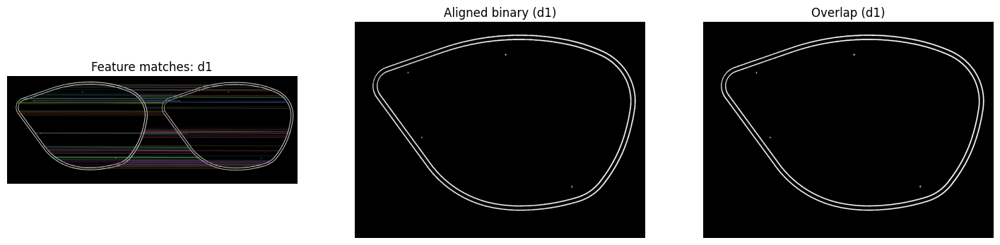

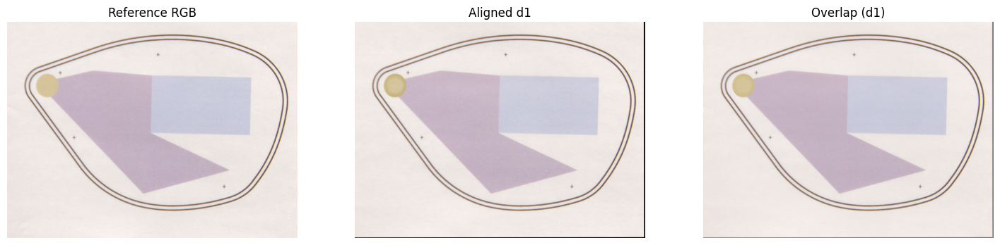

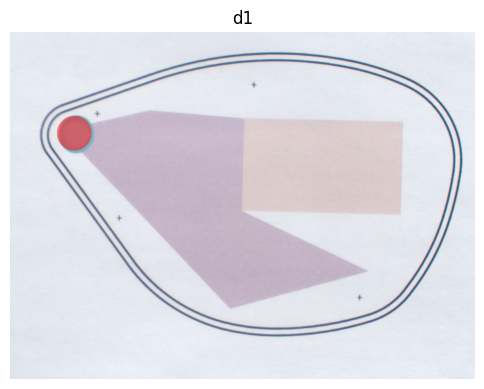

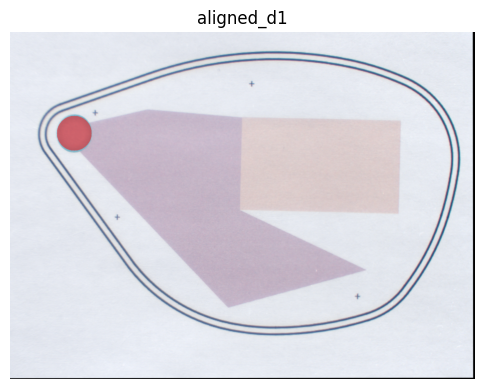

Aligning d2...


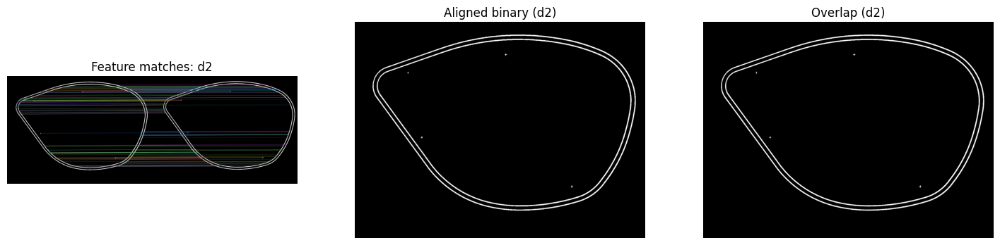

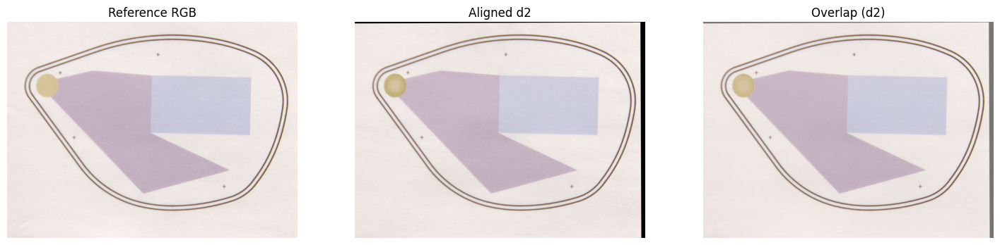

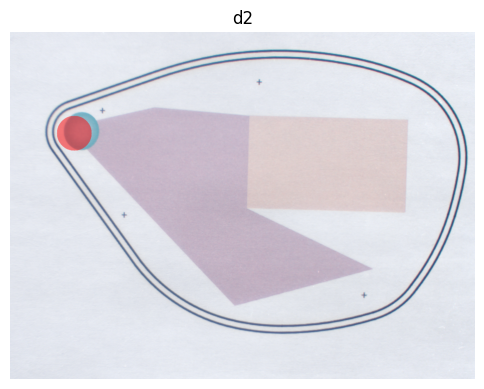

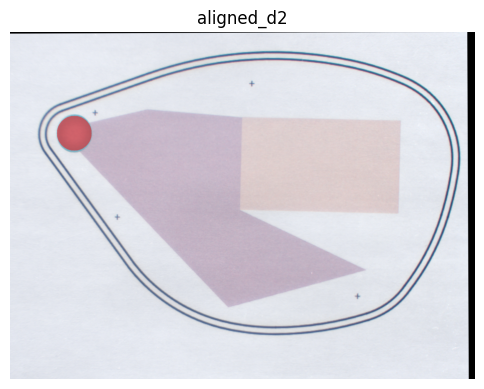

Aligning d3...


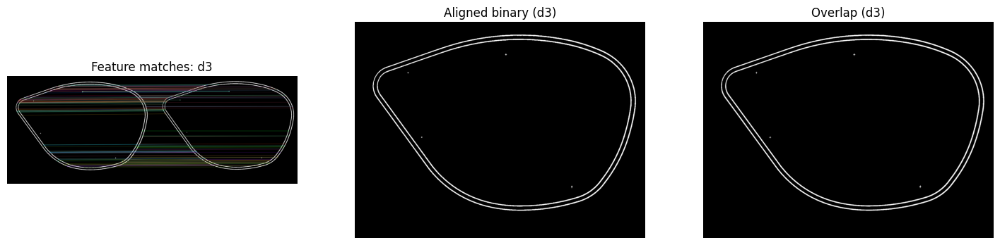

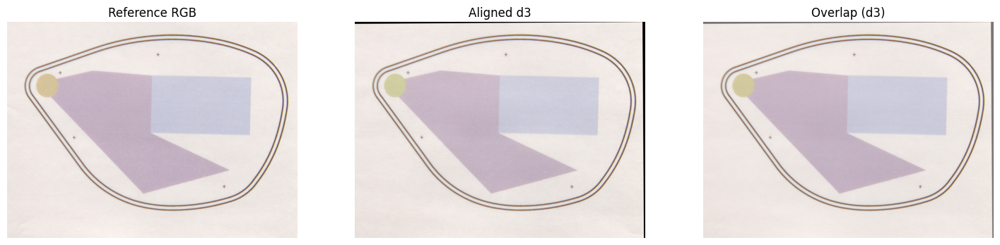

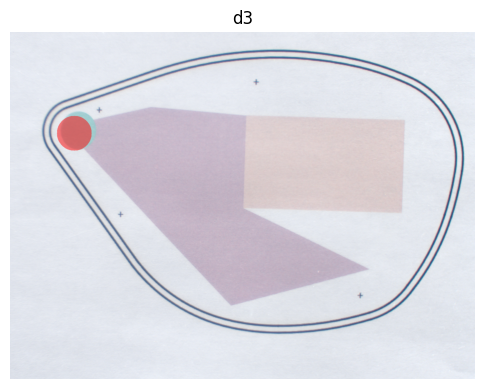

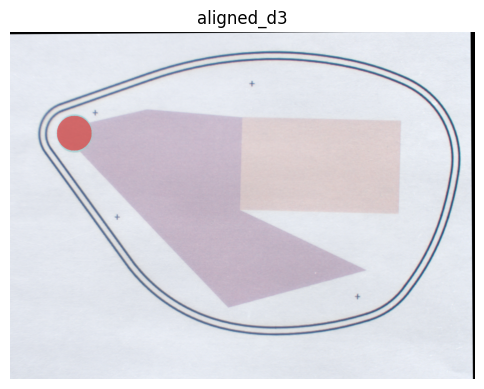

Aligning d4...


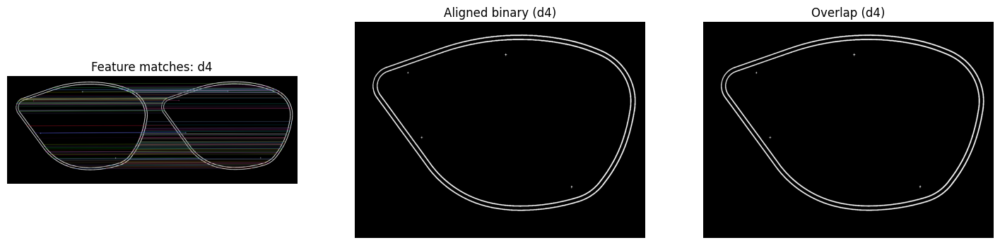

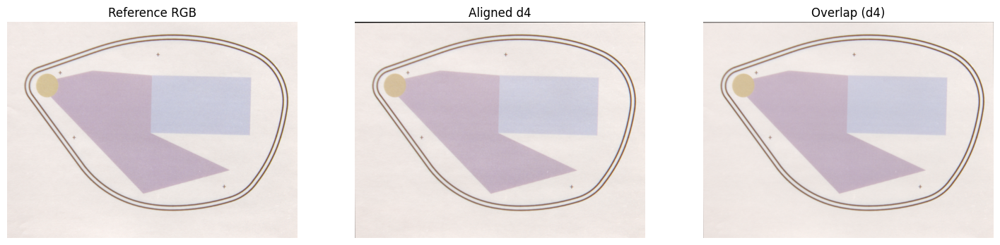

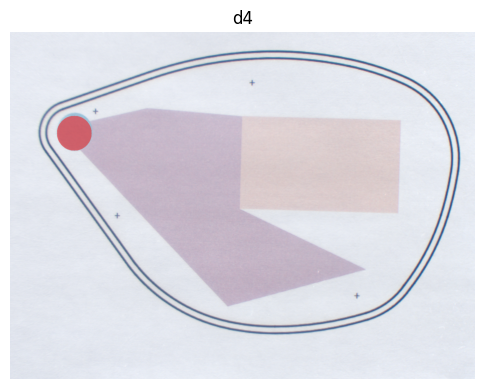

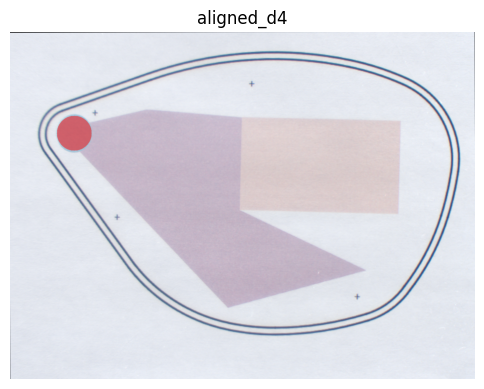

Aligning d5...


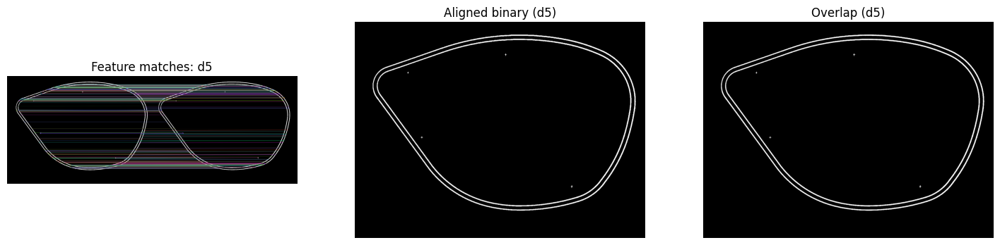

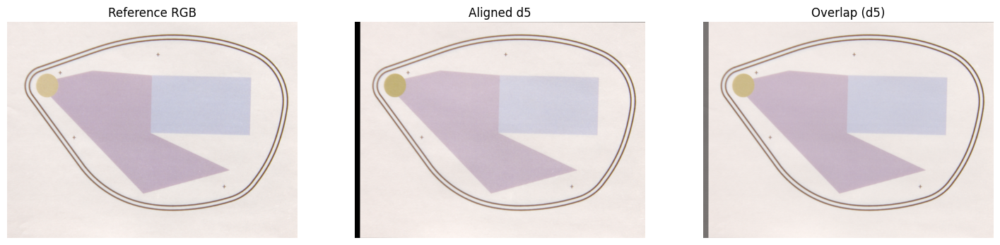

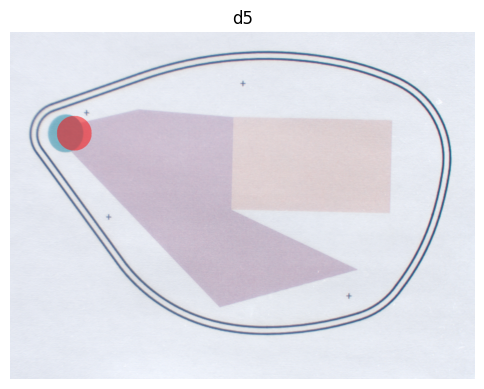

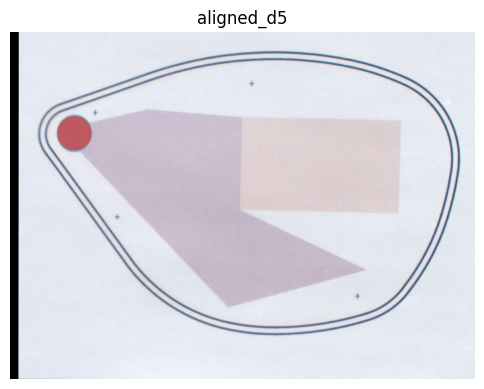

Aligning d6...


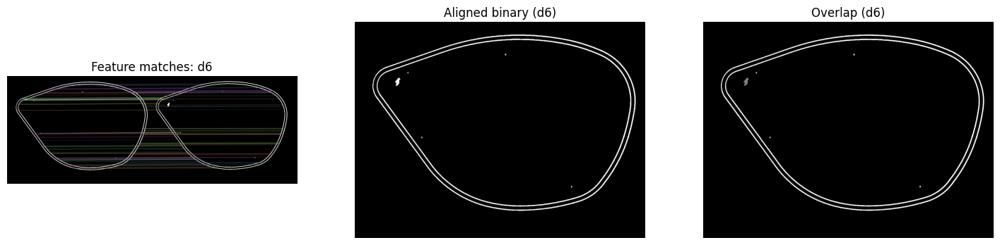

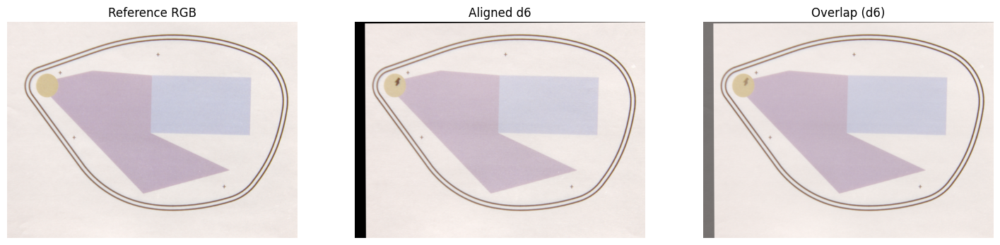

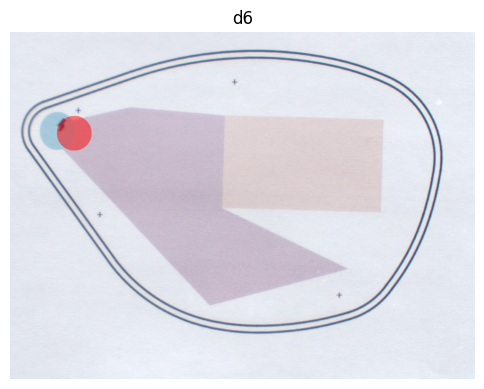

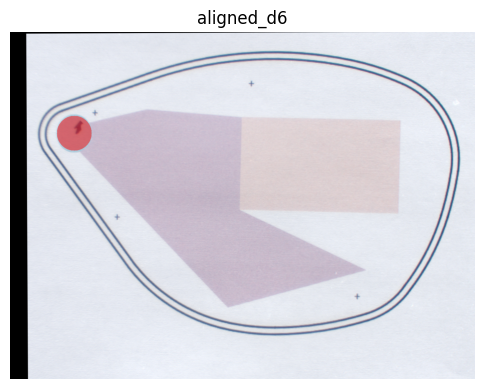

Aligning d7...


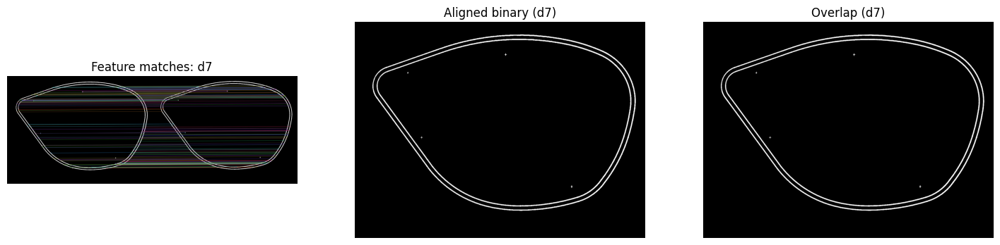

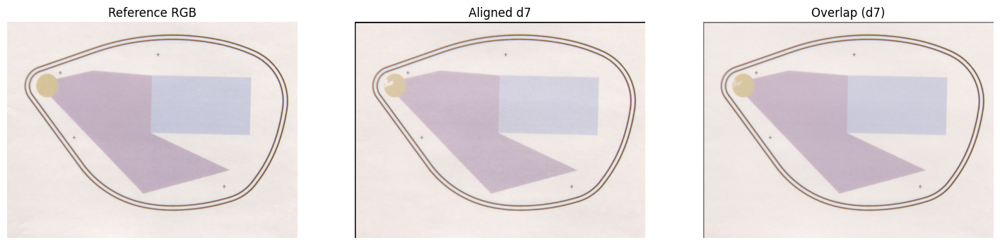

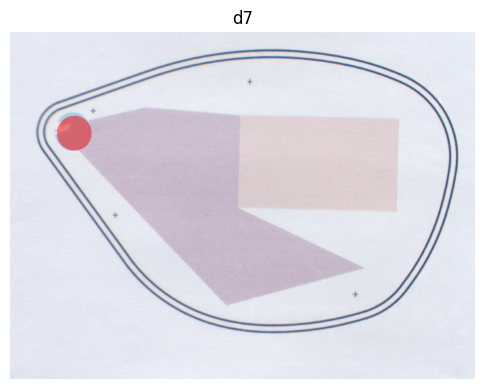

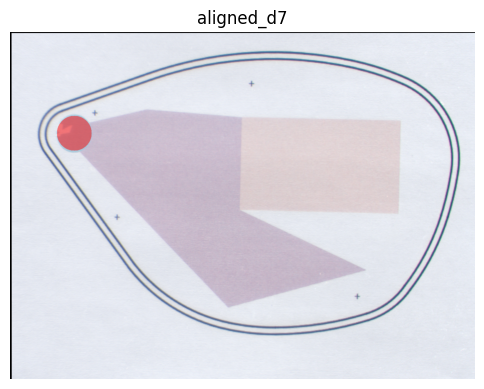

Aligning d8...


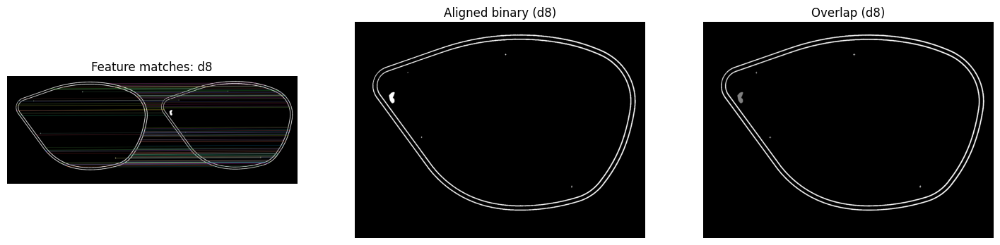

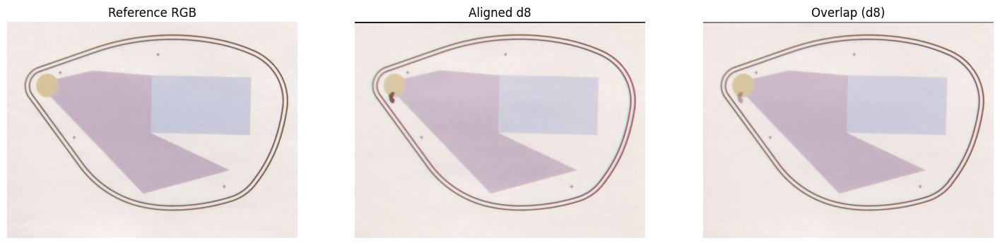

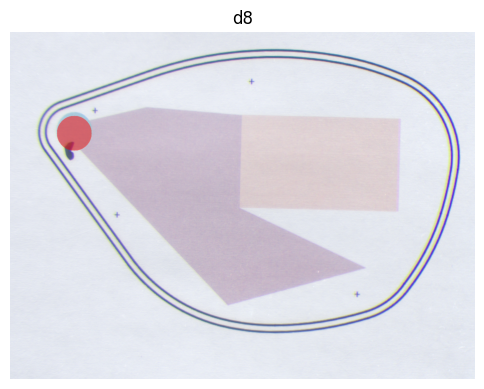

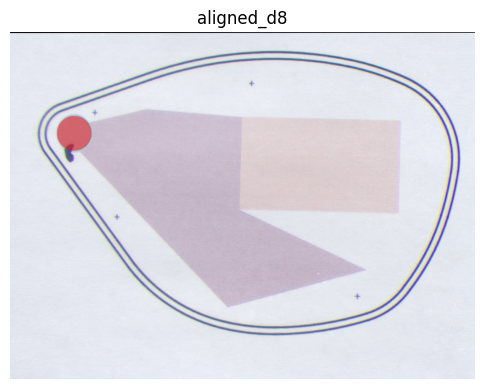

Aligning d9...


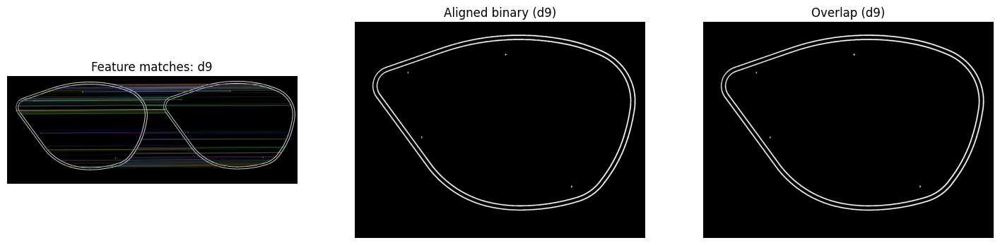

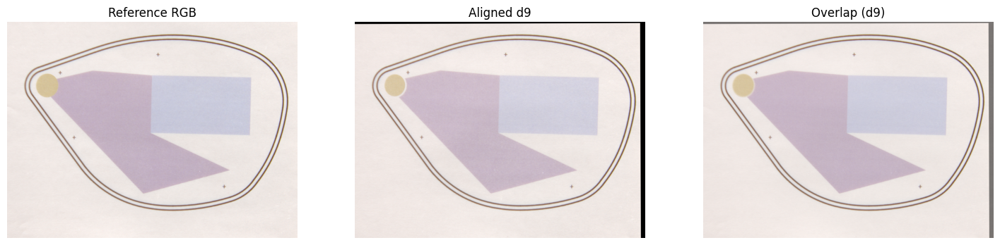

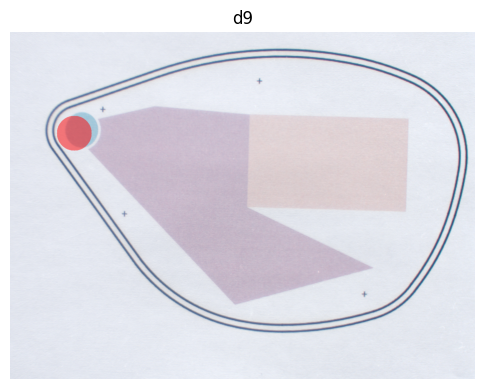

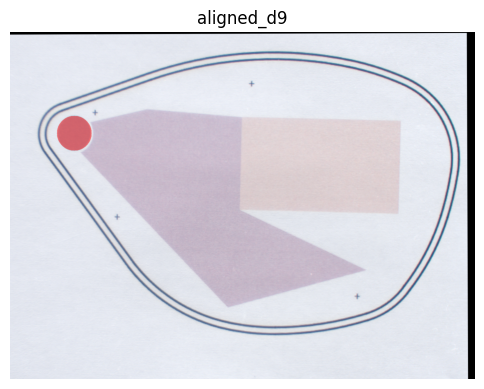

Aligning d10...


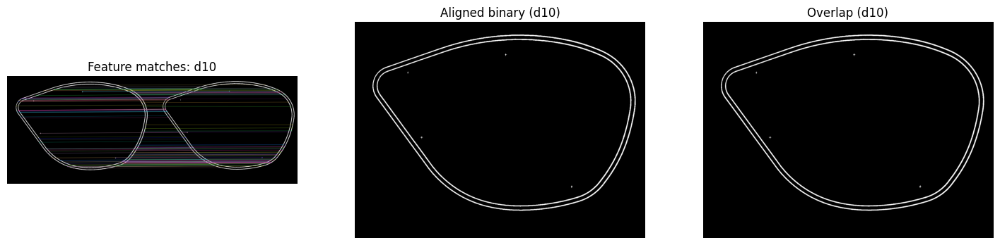

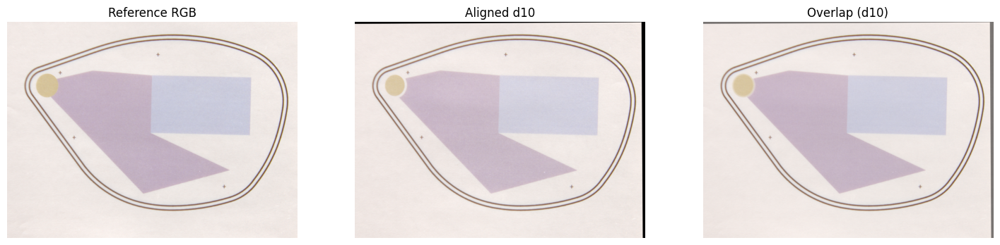

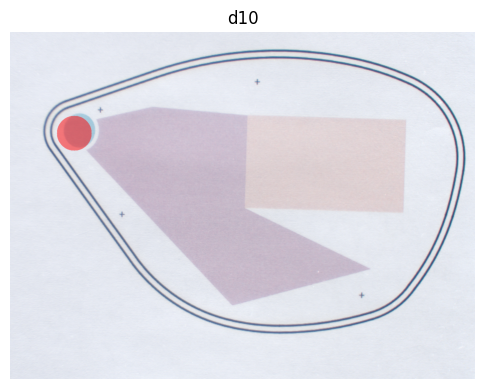

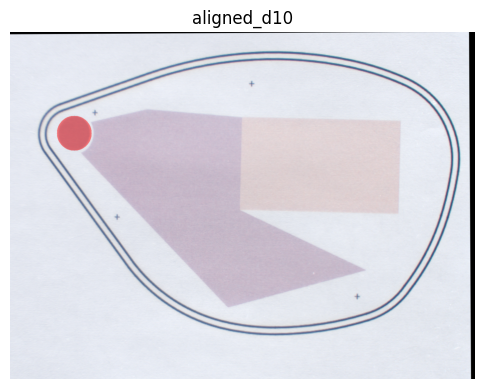

Aligning d11...


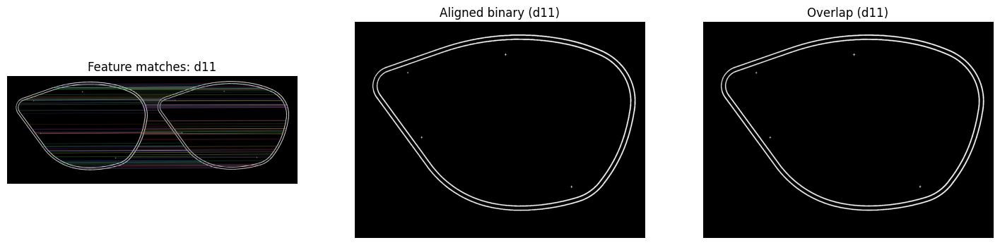

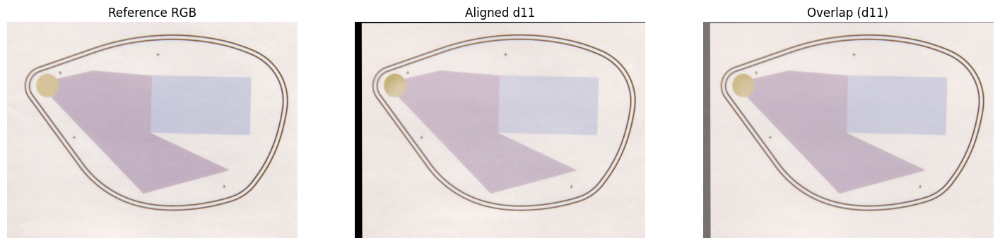

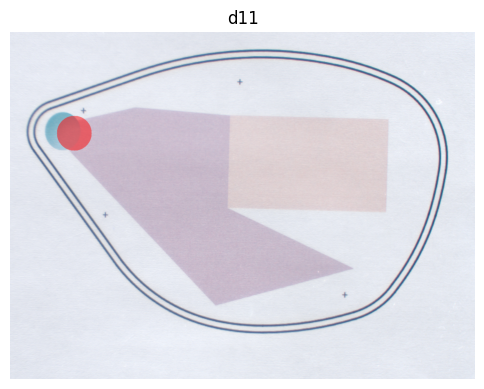

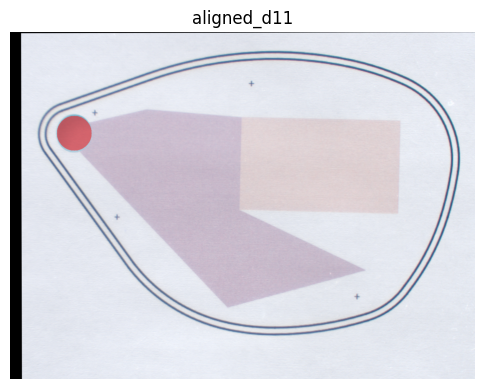

Aligning d12...


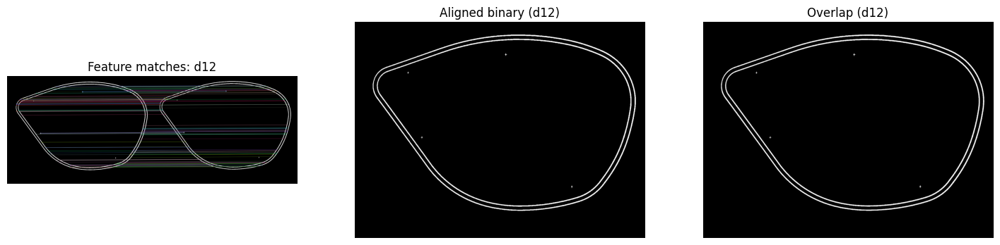

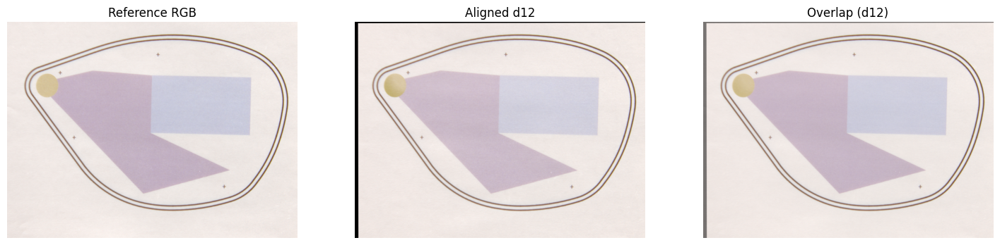

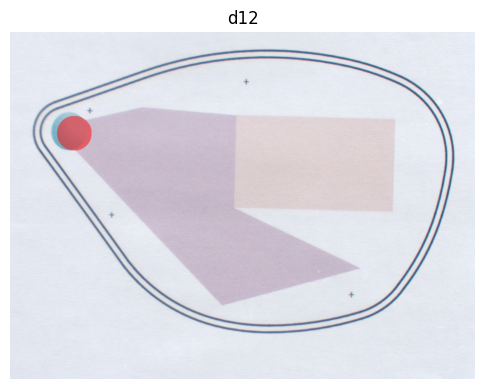

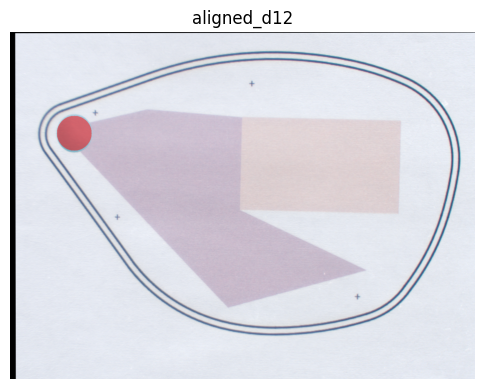

Aligning d13...


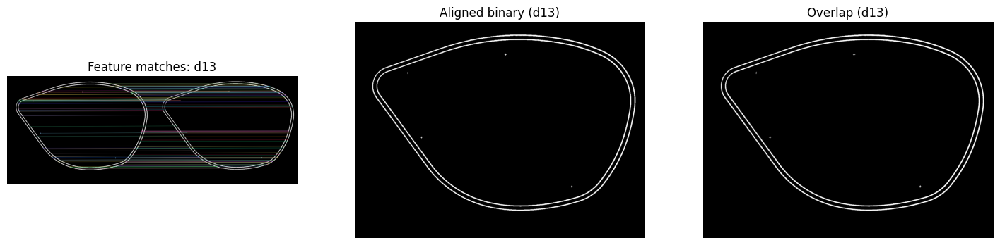

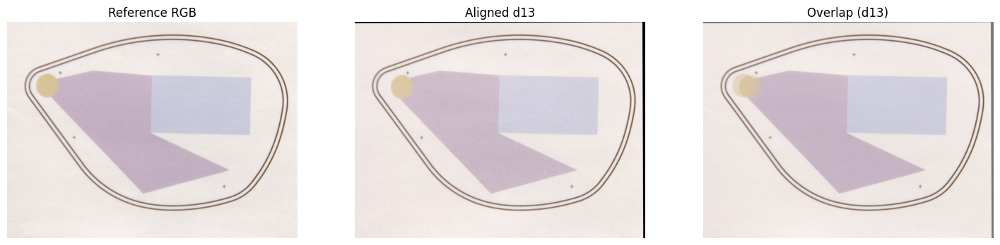

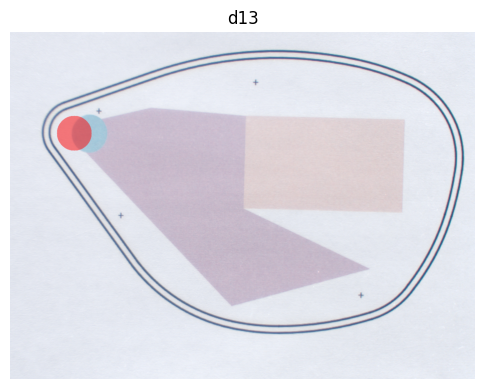

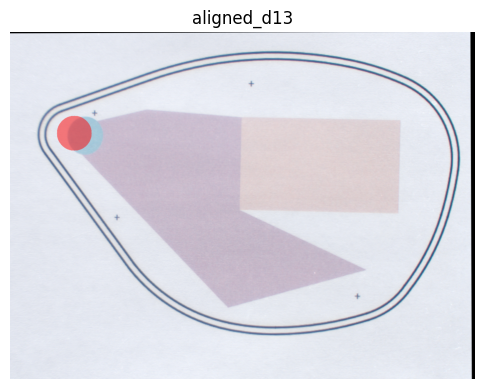

Aligning d14...


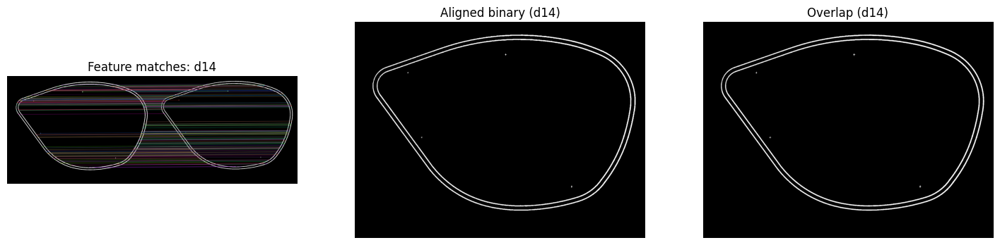

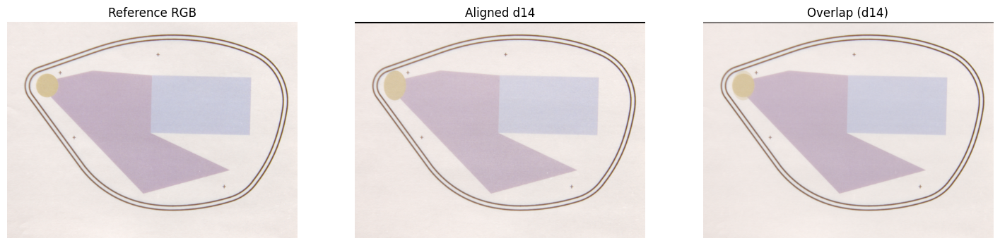

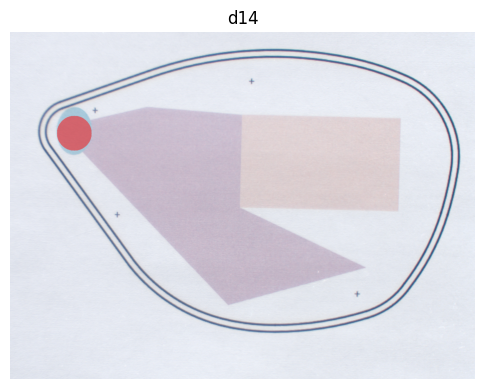

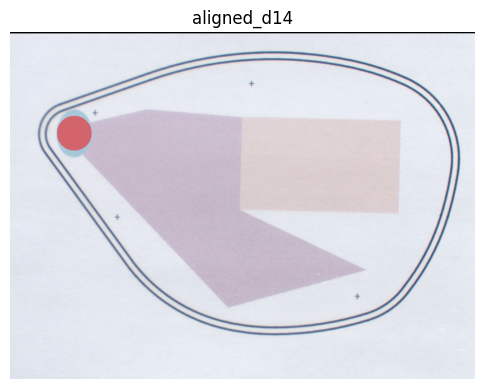

In [5]:
ref_mask = mask_ref
defect_homographies = []
defects = sample_folders
for defect in defects:
    print(f"Aligning {defect}...")

    # Spectral to XYZ to LAB
    cube_interp, _ = interpolate_spectral_cube(
        sample_cubes[defect], wavelengths, wl_min=360, wl_max=830, wl_step=10
    )
    cube_interp = np.transpose(cube_interp, (1, 2, 0))  # (H, W, b)

    def_XYZ = spim2XYZ(cube_interp, new_wavelengths, "D65")
    defect_rgb = XYZ2RGB(def_XYZ)

    # defect_rgb = spim2rgb(defect_cubes[defect], wavelengths)
    defect_binary = gray_to_binary_image(
        get_example_reflectance(sample_cubes, defect, band)
    )
    H = align_and_visualise_homography(
        ref_binary, defect_binary, defect, visualise=True
    )
    defect_homographies.append(H)

    if ref_rgb.dtype != np.uint8:
        ref_rgb = np.clip(ref_rgb * 255, 0, 255).astype(np.uint8)
    if defect_rgb.dtype != np.uint8:
        defect_rgb = np.clip(defect_rgb * 255, 0, 255).astype(np.uint8)

    aligned_defect, blended = align_and_blend_RGB_homography(
        ref_rgb, defect_rgb, H, defect
    )
    overlay_mask(defect_rgb, ref_mask, defect, color=(1, 0, 0), alpha=0.5)
    overlay_mask(
        aligned_defect, ref_mask, f"aligned_{defect}", color=(1, 0, 0), alpha=0.5
    )

4. CTQs without allignment


5. Compute CTQs for all defects


Processing d1...
[[ 9.99896621e-01  1.08102483e-03 -6.58401040e+00]
 [-1.08102483e-03  9.99896621e-01 -2.25799711e+00]]


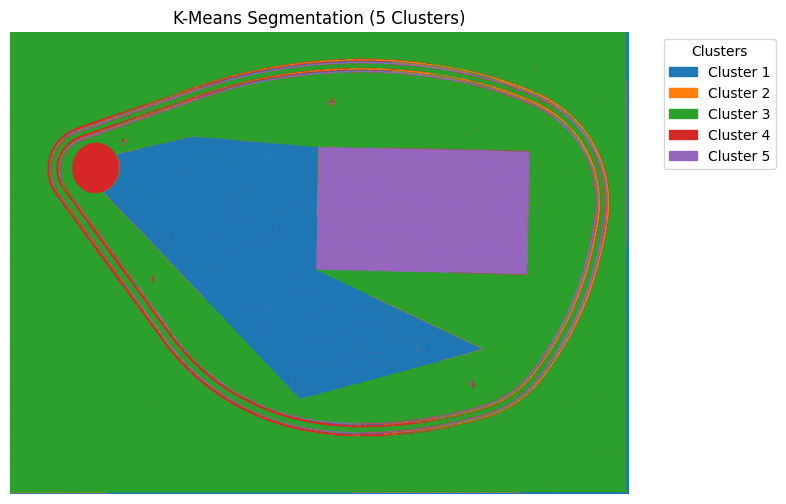

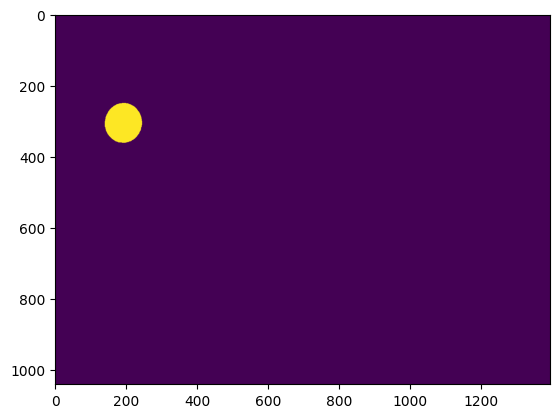

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


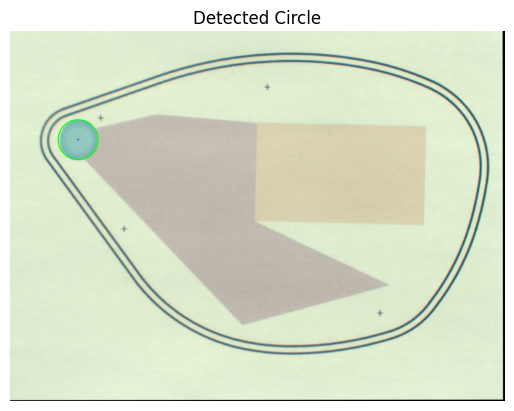

Processing d2...
[[ 9.99791227e-01  4.25897707e-03 -2.27817198e+01]
 [-4.25897707e-03  9.99791227e-01  7.92670496e+00]]


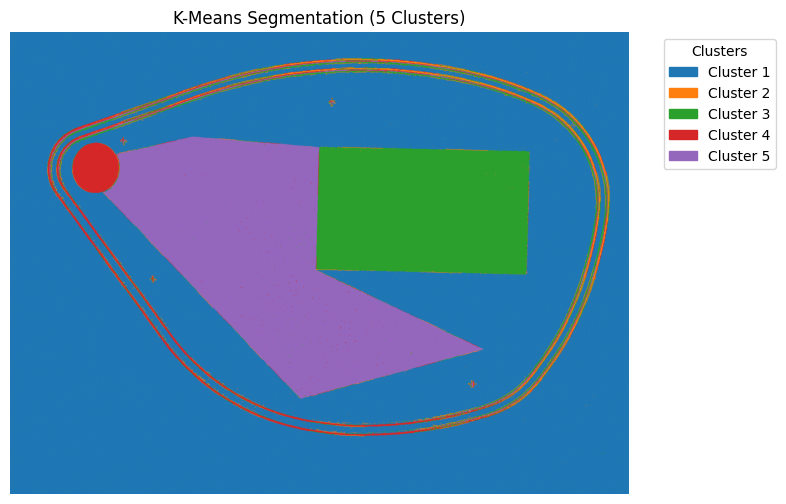

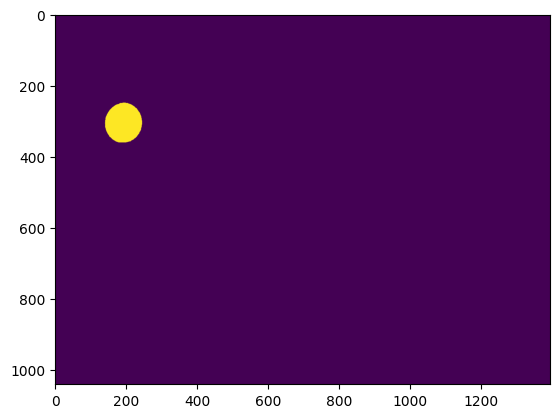

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


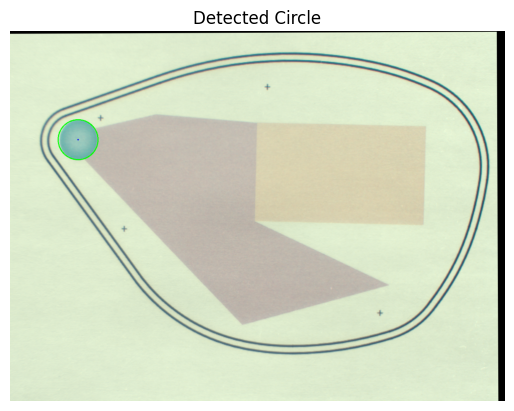

Processing d3...
[[ 1.00050724e+00  6.74584446e-03 -1.39294610e+01]
 [-6.74584446e-03  1.00050724e+00  9.93816159e+00]]


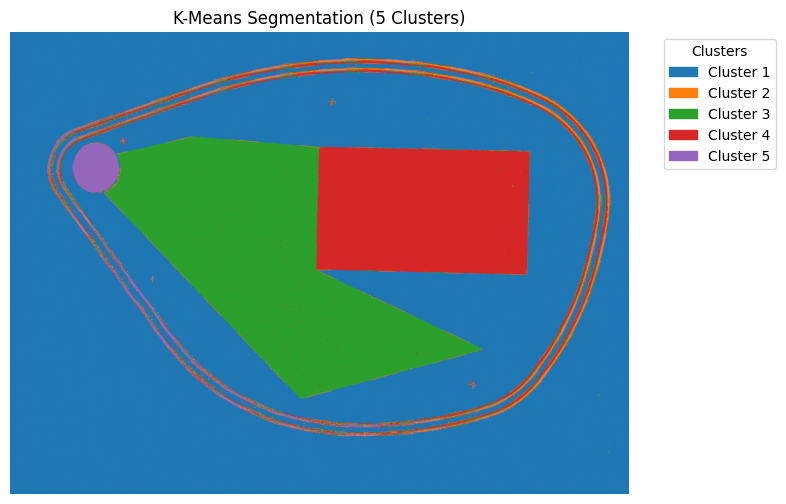

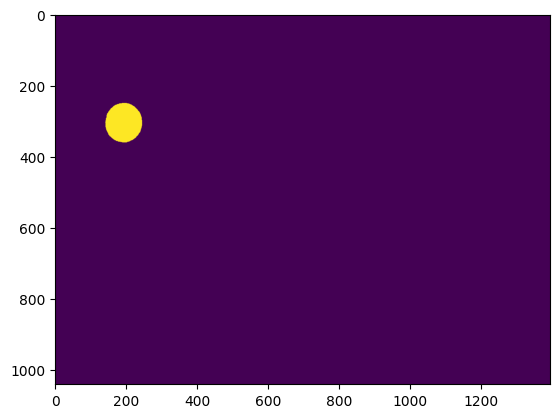

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


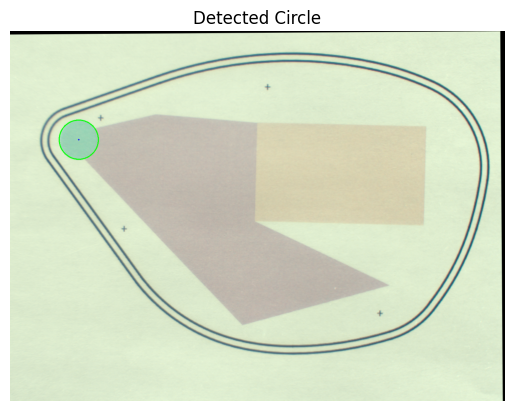

Processing d4...
[[ 1.00099886e+00  3.00448447e-03 -2.38680625e+00]
 [-3.00448447e-03  1.00099886e+00  5.07056031e+00]]


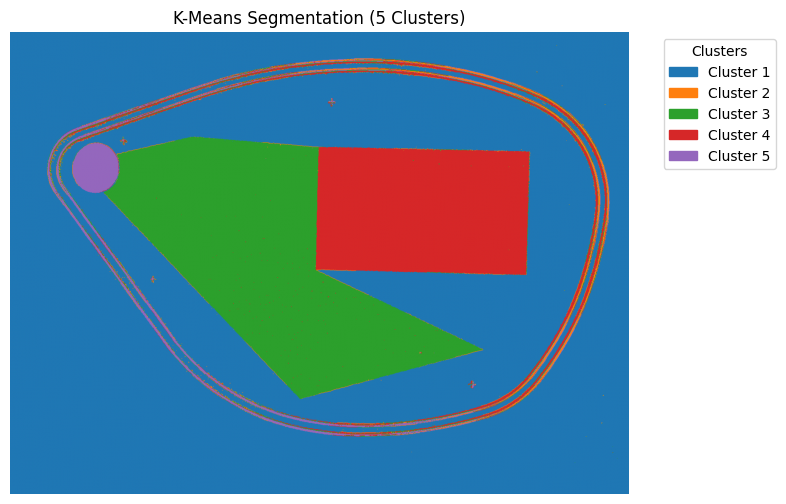

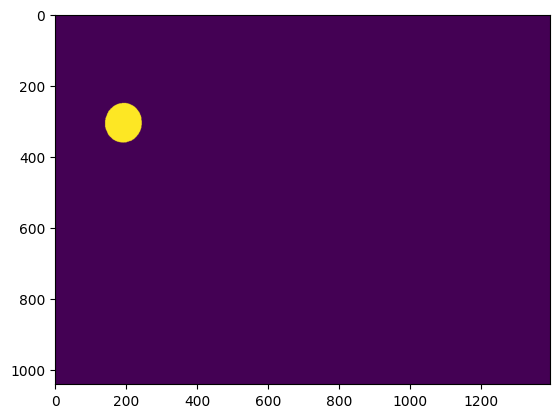

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


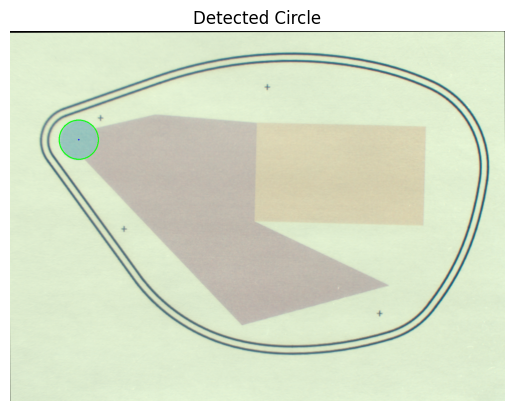

Processing d5...
[[ 1.00007447e+00 -5.37264009e-05  2.61639544e+01]
 [ 5.37264009e-05  1.00007447e+00  1.41517692e-01]]


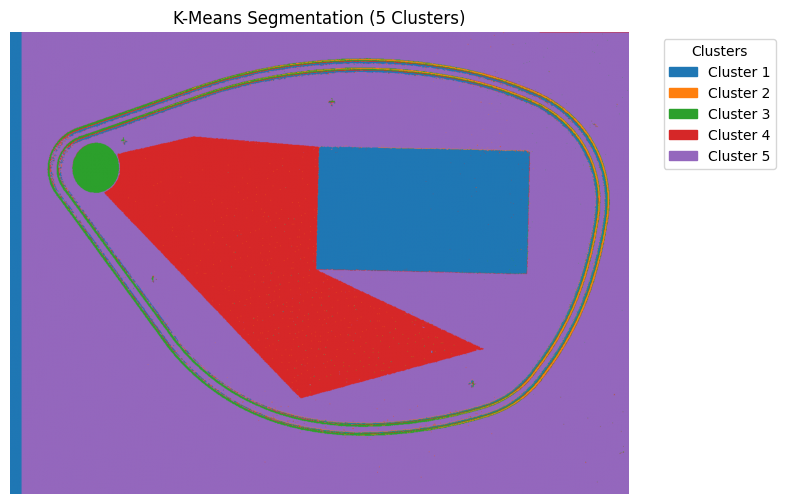

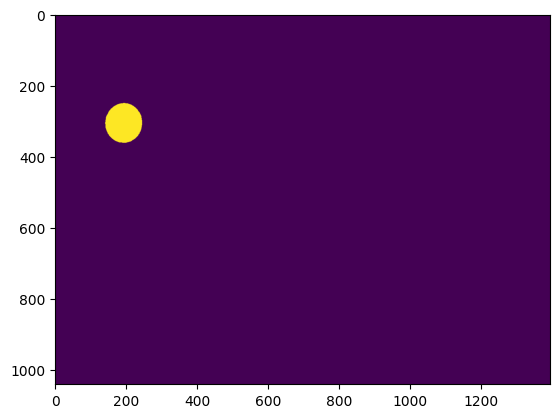

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


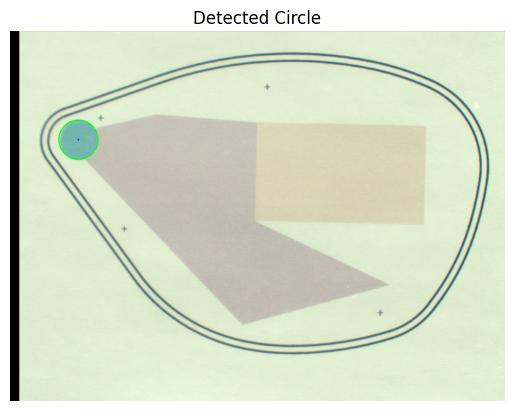

Processing d6...
[[ 1.00124572e+00  4.45753866e-03  4.88904524e+01]
 [-4.45753866e-03  1.00124572e+00  7.66054395e+00]]


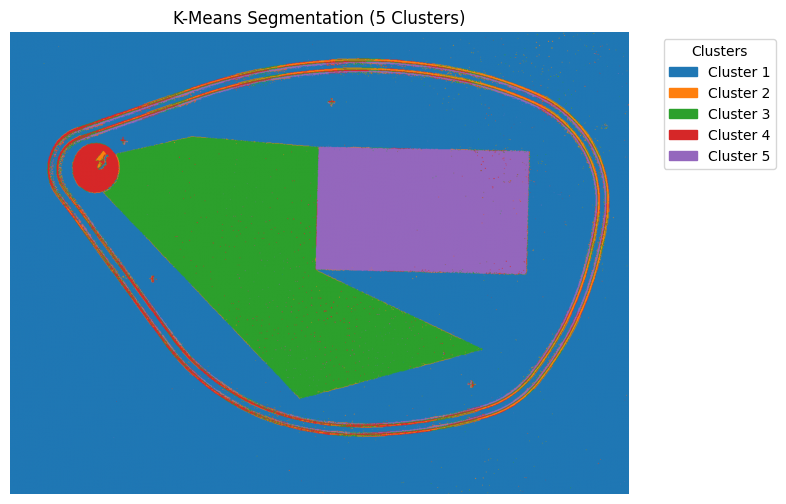

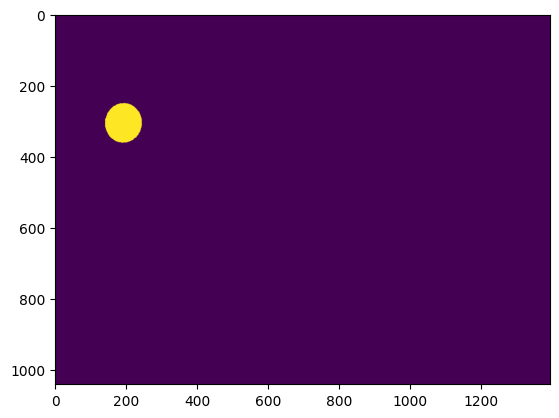

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


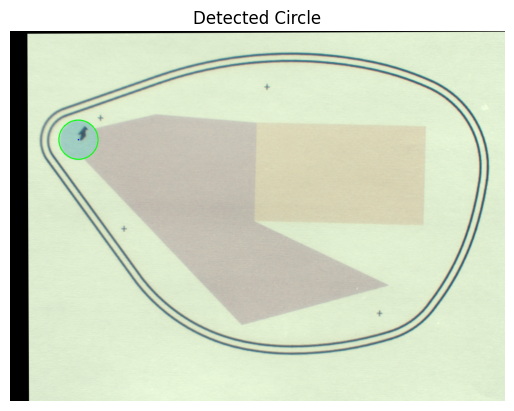

Processing d7...
[[ 1.00069490e+00  5.71815459e-04  4.59045076e+00]
 [-5.71815459e-04  1.00069490e+00  6.10102561e+00]]


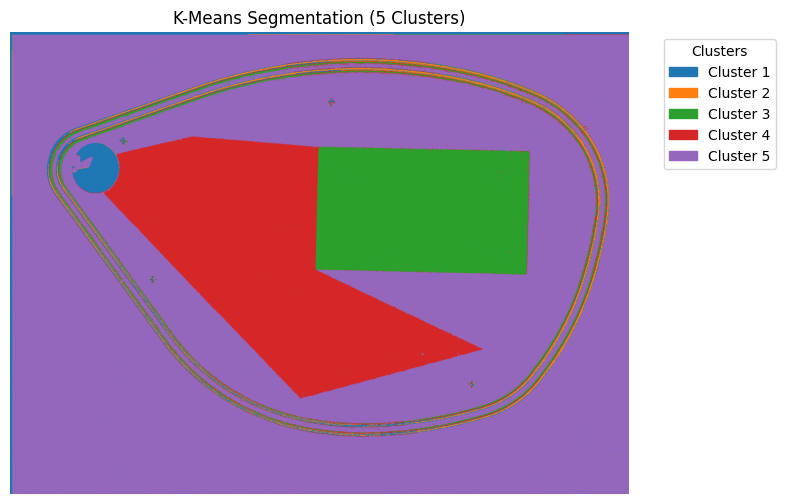

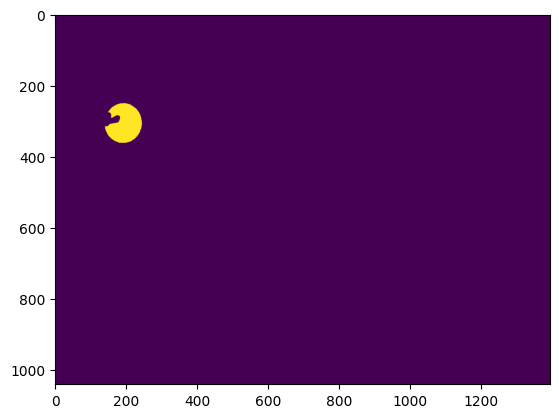

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


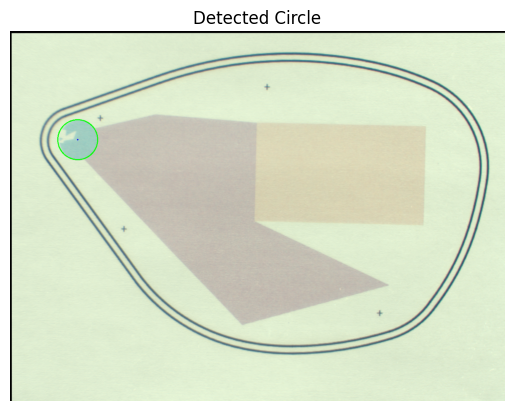

Processing d8...
[[ 1.00089698e+00  7.78382115e-04 -8.97324030e-01]
 [-7.78382115e-04  1.00089698e+00  6.09202650e+00]]


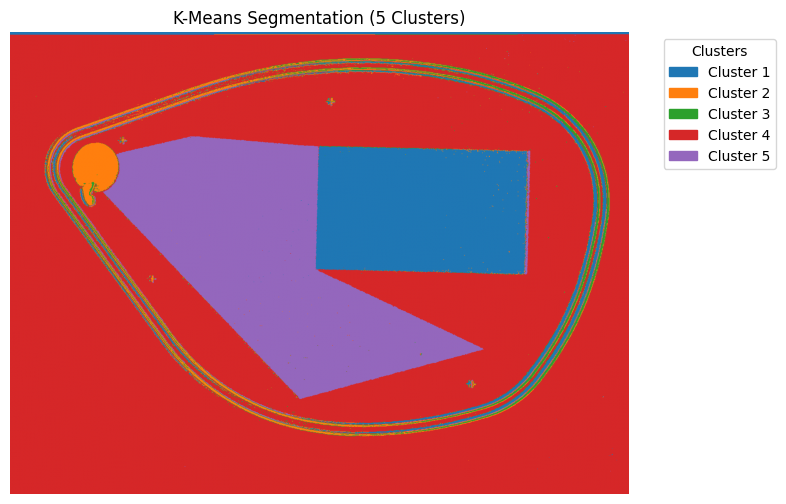

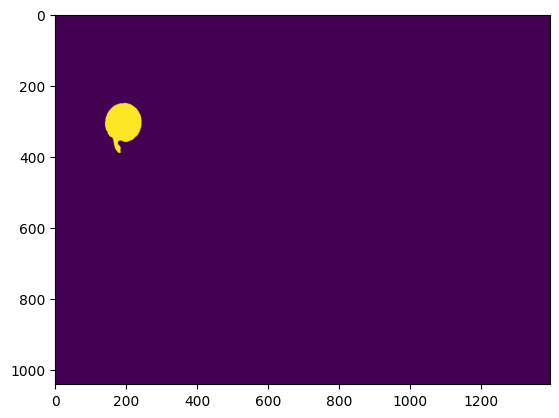

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


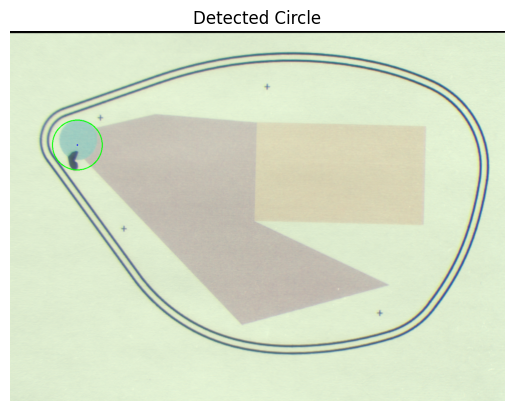

Processing d9...
[[ 9.99488774e-01  4.11511546e-03 -2.37112195e+01]
 [-4.11511546e-03  9.99488774e-01  1.10588781e+01]]


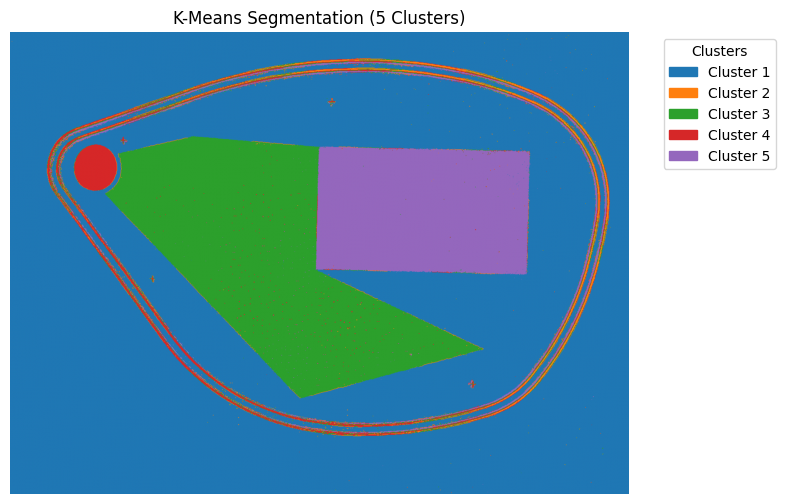

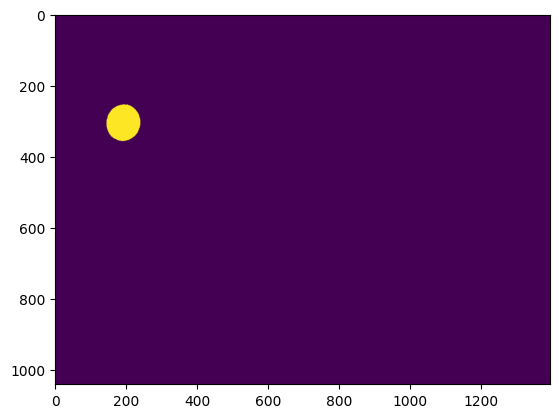

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


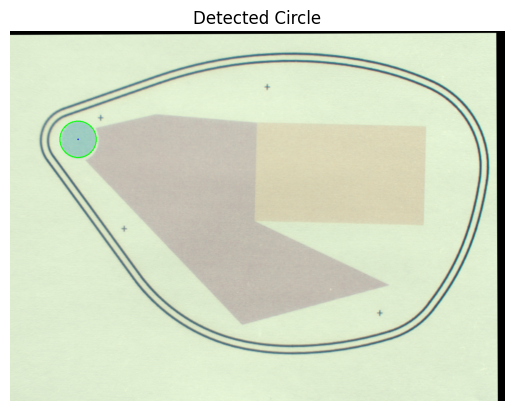

Processing d10...
[[ 9.99807090e-01  5.78741940e-03 -1.75886064e+01]
 [-5.78741940e-03  9.99807090e-01  9.92499338e+00]]


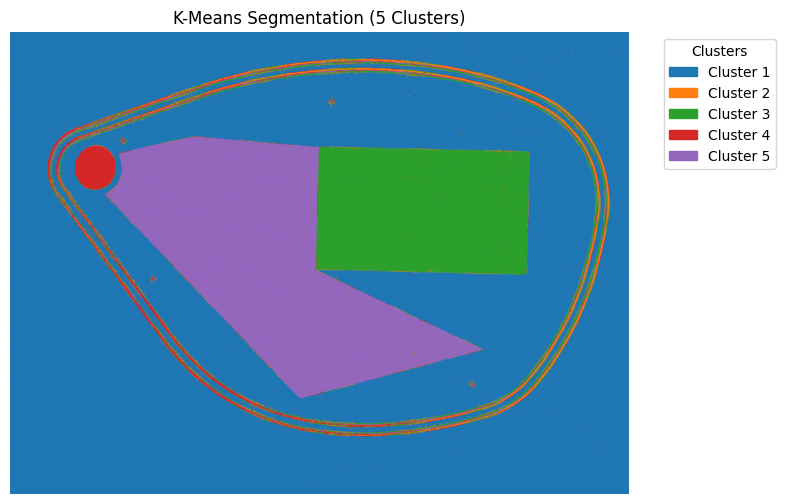

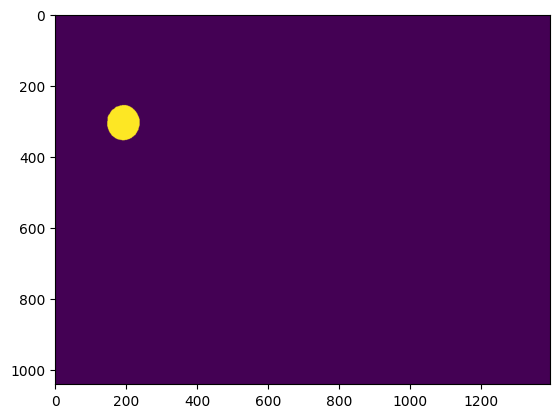

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


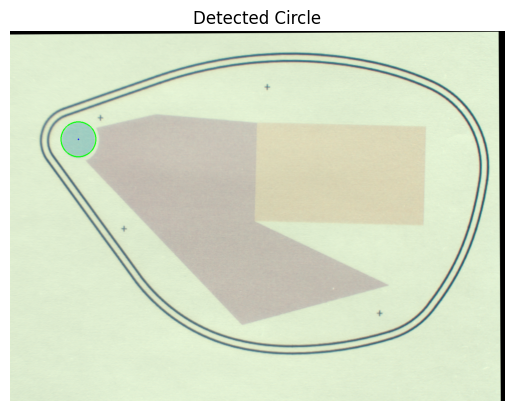

Processing d11...
[[ 1.00143529e+00  2.53315774e-03  3.31575167e+01]
 [-2.53315774e-03  1.00143529e+00  6.53079023e+00]]


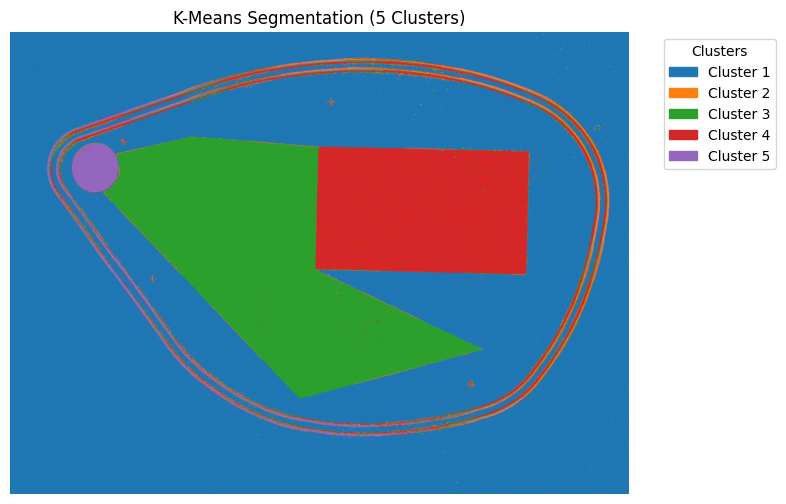

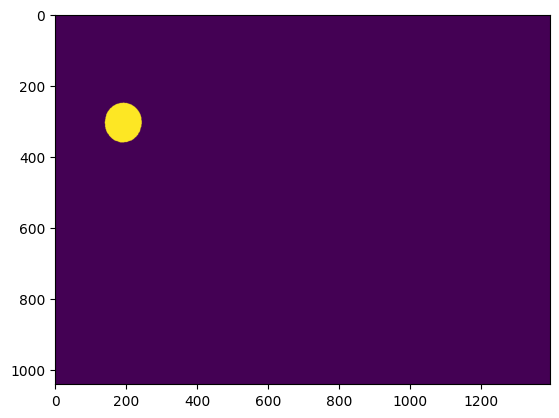

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


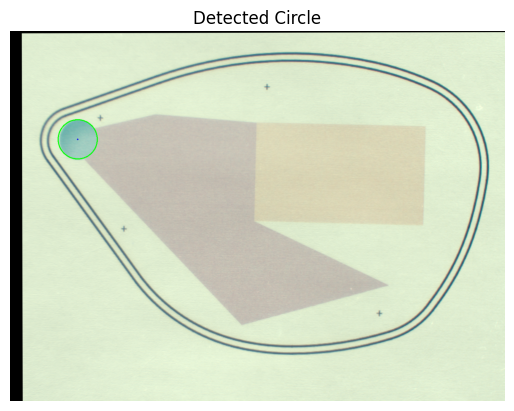

Processing d12...
[[ 1.00126552e+00  1.52675163e-03  1.57140704e+01]
 [-1.52675163e-03  1.00126552e+00  6.66666507e+00]]


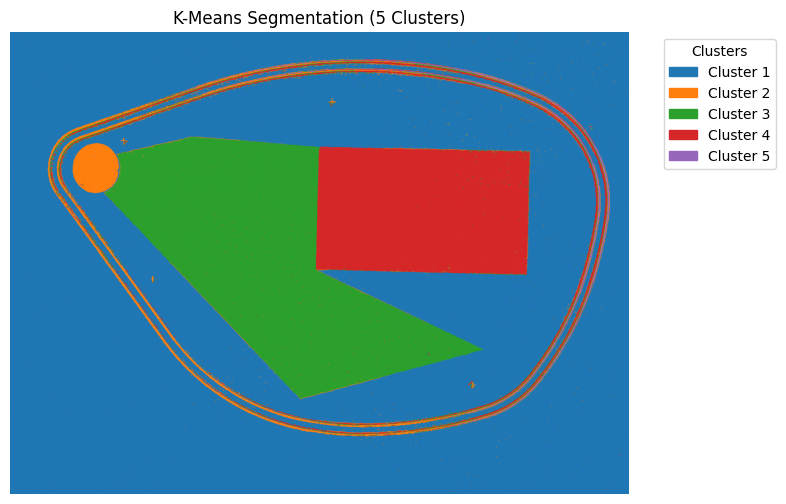

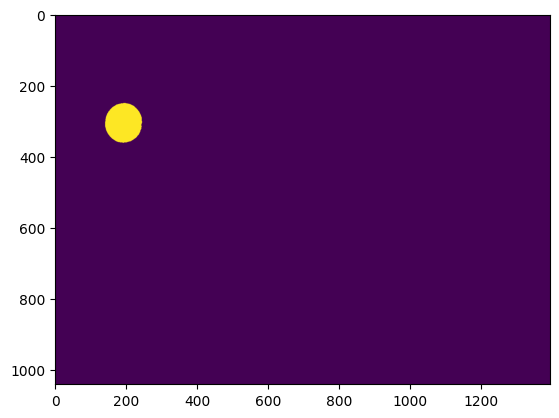

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


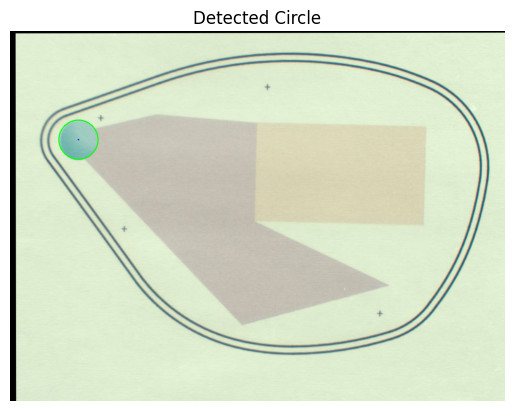

Processing d13...
[[ 9.99896741e-01  3.16689523e-03 -1.29647493e+01]
 [-3.16689523e-03  9.99896741e-01  6.31031448e+00]]


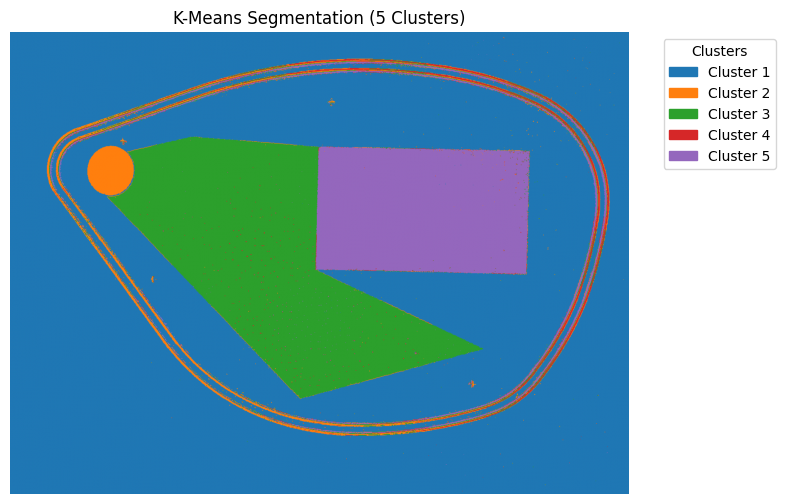

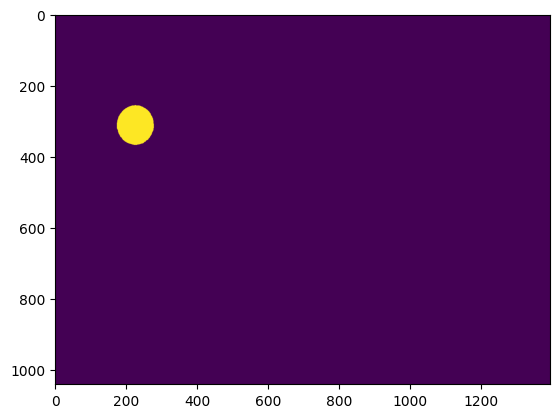

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


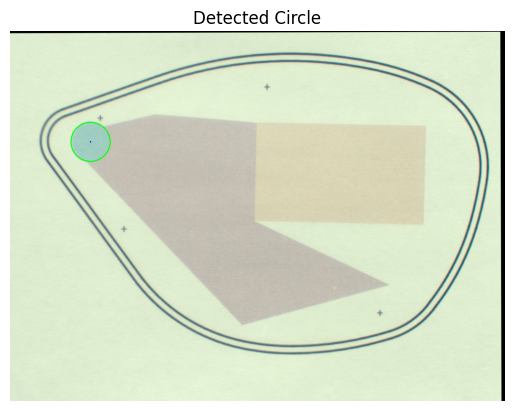

Processing d14...
[[ 1.00029144e+00  3.16649562e-04 -4.09571325e-01]
 [-3.16649562e-04  1.00029144e+00  7.26082956e+00]]


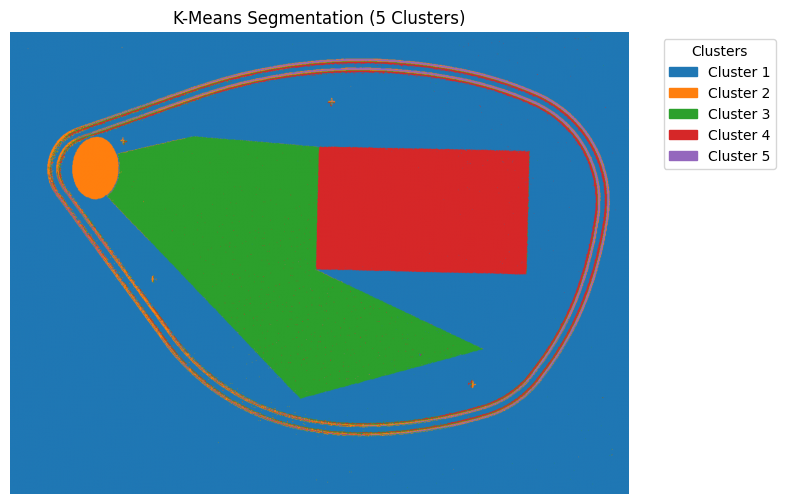

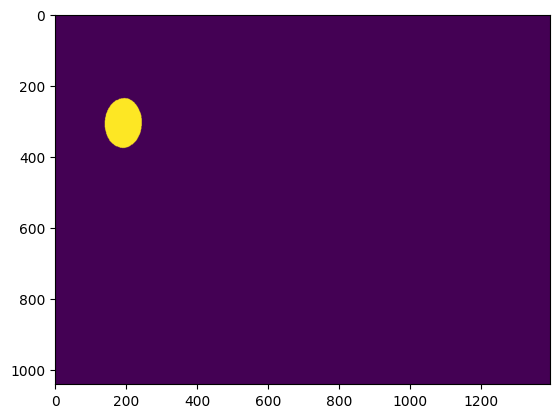

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..255.0].


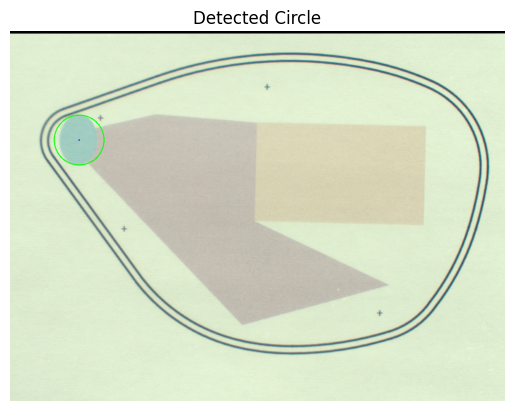

In [7]:
deltaE_results = []
defects_radius = []
defects_aligned = []

for i, defect_name in enumerate(defects):
    print(f"Processing {defect_name}...")

    # CTQ2 (in RGB)

    # Spectral to XYZ to RGB
    cube_interp, _ = interpolate_spectral_cube(
        defect_cubes[defect_name], wavelengths, wl_min=360, wl_max=830, wl_step=10
    )
    cube_interp = np.transpose(cube_interp, (1, 2, 0))  # (H, W, b)

    def_XYZ = spim2XYZ(cube_interp, new_wavelengths, "D65")
    rgb_vis = XYZ2RGB(def_XYZ)

    # Align defect
    A_3x3 = defect_homographies[i]
    print(A_3x3)
    A_2x3 = A_3x3[:2, :]
    defect_rgb = spim2rgb(defect_cubes[defect_name], wavelengths)
    h, w, b = defect_rgb.shape
    aligned_defect = cv2.warpAffine(defect_rgb, A_2x3, (w, h))
    defects_aligned.append(aligned_defect)

    # Compute defect mask of IC to find circle radius
    defect_mask = compute_IC_mask(defect_rgb, A_2x3, True, circle_center)
    defect_circle_info = get_circle_info(defect_mask, aligned_defect, True)
    defects_radius.append(defect_circle_info["min_enclosing_circle"]["radius"])

    # Masked CTQ for visualization
    aligned_vis = cv2.warpAffine(rgb_vis, A_2x3, (w, h))
    cropped_circle = crop_circle(aligned_vis, circle_center, circle_radius)
    cropped_circles.append(cropped_circle)

    # CTQ1 (all spectra)
    # Compute spectral average
    cube = defect_cubes[defect_name]
    bands, h, w = cube.shape

    # Align full cube
    cube_aligned = np.stack(
        [cv2.warpAffine(cube[j], A_3x3[:2, :], (w, h)) for j in range(bands)]
    )

    # Spectral to XYZ to LAB
    cube_interp, _ = interpolate_spectral_cube(
        cube_aligned, wavelengths, wl_min=360, wl_max=830, wl_step=10
    )
    cube_interp = np.transpose(cube_interp, (1, 2, 0))  # (H, W, b)

    def_XYZ = spim2XYZ(cube_interp, new_wavelengths, "D65")
    def_LAB = XYZ2Lab(def_XYZ, new_wavelengths, "D65")

    # CIelab delta E with reference
    DE_mean = calculate_delta_E(ref_LAB, def_LAB, mask=mask_ref)
    deltaE_results.append(DE_mean)

In [8]:
defects_radius

[56.1472282409668,
 56.51558303833008,
 55.47915267944336,
 55.73166275024414,
 55.818336486816406,
 55.64405822753906,
 56.078155517578125,
 70.78321838378906,
 51.840694427490234,
 49.38909912109375,
 55.84718704223633,
 55.701595306396484,
 55.64772033691406,
 70.11428833007812]

7. Create df to save results


In [9]:
# Save results to df
result_df = pd.DataFrame()
result_df["defect_id"] = defects
result_df["DE_mean"] = deltaE_results
result_df["D_radius"] = abs(np.array(defects_radius) - circle_radius)

result_df["CTQ1"] = np.array(deltaE_results) > 2.8
result_df["CTQ2"] = (
    abs(np.array(defects_radius) - circle_radius) > 1.2
)  # new reference  50

result_df["Defect?"] = result_df["CTQ1"] | result_df["CTQ2"]

if test:
    result_df.to_csv(f"deltaE_results_test{trial}_operator{operator}.csv", index=False)
else:
    result_df.to_csv("deltaE_results_train.csv", index=False)
print("\nAverage DE (CIE2000) values per defect:")
print(result_df)


Average DE (CIE2000) values per defect:
   defect_id   DE_mean   D_radius   CTQ1   CTQ2  Defect?
0         d1  2.858682   0.467892   True  False     True
1         d2  4.467037   0.099537   True  False     True
2         d3  7.817676   1.135967   True  False     True
3         d4  2.718376   0.883457  False  False    False
4         d5  6.554200   0.796783   True  False     True
5         d6  4.502364   0.971062   True  False     True
6         d7  4.175619   0.536964   True  False     True
7         d8  4.092232  14.168098   True   True     True
8         d9  2.961520   4.774426   True   True     True
9        d10  3.954703   7.226021   True   True     True
10       d11  3.539423   0.767933   True  False     True
11       d12  3.674849   0.913525   True  False     True
12       d13  7.515473   0.967400   True  False     True
13       d14  2.744447  13.499168  False   True     True


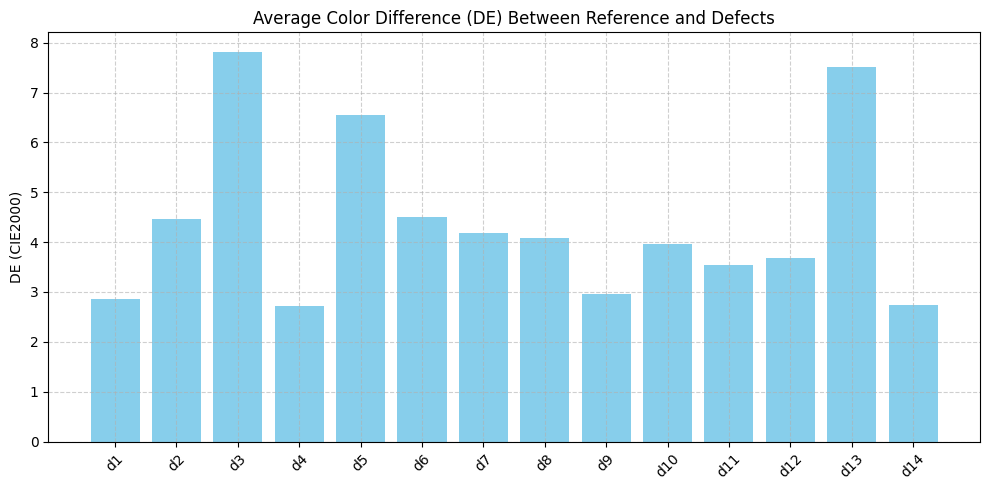

In [10]:
# Plot delta E differences
plt.figure(figsize=(10, 5))
plt.bar(result_df["defect_id"], result_df["DE_mean"], color="skyblue")
plt.ylabel("DE (CIE2000)")
plt.title("Average Color Difference (DE) Between Reference and Defects")
plt.xticks(rotation=45)
plt.grid(True, linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

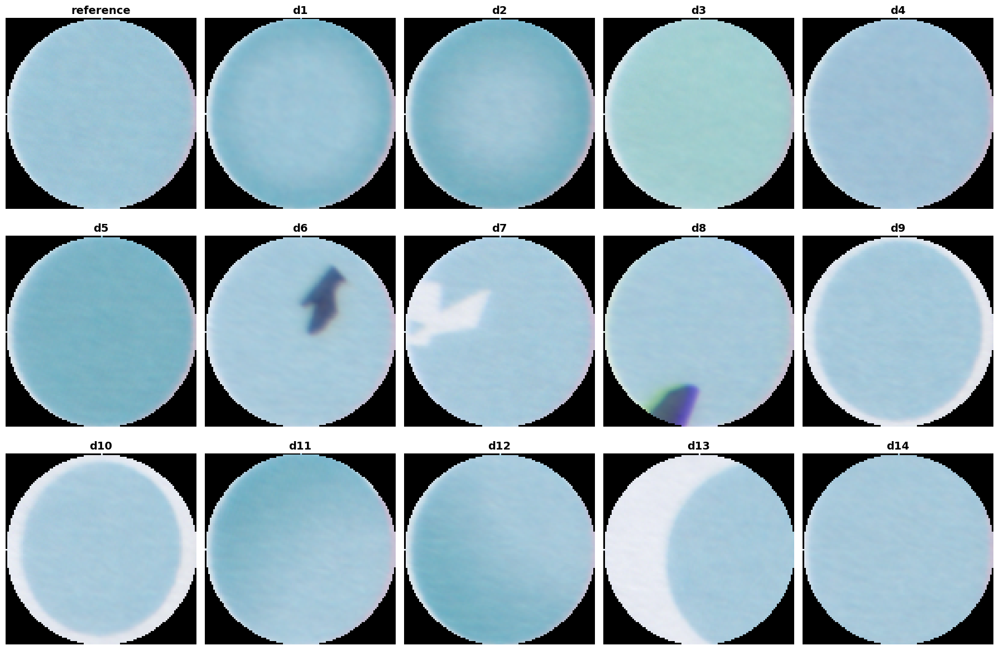

In [11]:
# Plot masked IC region
titles = ["reference"] + defects
plt.figure(figsize=(18, 12))
cols = 5
rows = math.ceil((len(defects) + 1) / cols)
for idx, (img, title) in enumerate(zip(cropped_circles, titles)):
    plt.subplot(rows, cols, idx + 1)
    if img.ndim == 2:
        plt.imshow(img, cmap="gray")
    else:
        plt.imshow(img)
    plt.title(title, fontsize=14, fontweight="bold")
    plt.axis("off")

# plt.suptitle(
#     "Detected IC Region (Reference + 14 Aligned Defects)",
#     fontsize=18,
#     fontweight="bold",
# )
plt.tight_layout()
plt.show()

6. Average reflectance in Circle


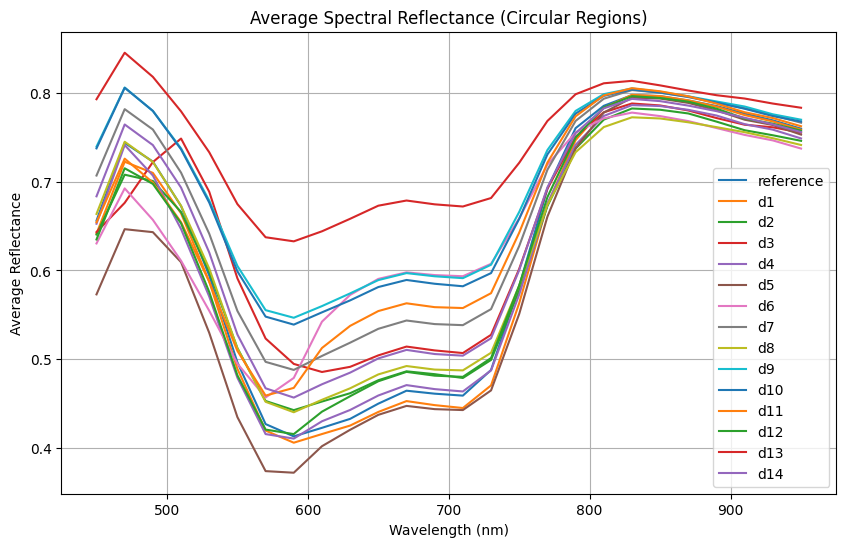

In [12]:
# Plot average spectra of each defect
for defect_name in defects:
    cube = defect_cubes[defect_name]
    spec = average_reflectance_in_circle(
        cube, circle_center, circle_radius, transform=A_3x3
    )
    spectra[defect_name] = spec
plt.figure(figsize=(10, 6))
for name, spectrum in spectra.items():
    # if name == "reference" or name == "d4":
    #     plt.plot(wavelengths, spectrum, label=name)
    plt.plot(wavelengths, spectrum, label=name)

plt.xlabel("Wavelength (nm)")
plt.ylabel("Average Reflectance")
plt.title("Average Spectral Reflectance (Circular Regions)")
plt.legend()
plt.grid(True)
plt.show()

In [13]:
def std_reflectance_in_circle(hypercube, center, radius, transform=None):
    bands, h, w = hypercube.shape

    hypercube_aligned = np.stack(
        [cv2.warpAffine(hypercube[i], transform, (w, h)) for i in range(bands)]
    )

    mask = np.zeros((h, w), dtype=np.uint8)
    cx, cy = int(round(center[0])), int(round(center[1]))
    r = int(radius) - 5
    cv2.circle(mask, (cx, cy), r, 1, -1)

    std_reflectance = []
    for i in range(bands):
        band = hypercube_aligned[i]
        masked_pixels = band[mask == 1]
        if masked_pixels.size > 0:
            std_reflectance.append(np.std(masked_pixels))
        else:
            std_reflectance.append(np.nan)

    return np.array(std_reflectance)


new_spectra = {}
new_spectra_std = {}

for defect_name, transform in zip(defects, defect_homographies):
    cube = defect_cubes[defect_name]
    new_spectra[defect_name] = average_reflectance_in_circle(
        cube, circle_center, circle_radius, transform=transform
    )
    new_spectra_std[defect_name] = std_reflectance_in_circle(
        cube, circle_center, circle_radius, transform=transform
    )


for defect_name in defects:
    std_values = new_spectra_std[defect_name]
    mean_values = new_spectra[defect_name]

    print(
        f"{defect_name}: Mean Std across wavelengths = {np.nanmean(std_values):.6f}, Coefficient of Variation (mean) = {np.nanmean(std_values/mean_values)*100:.2f}%"
    )

d1: Mean Std across wavelengths = 0.030163, Coefficient of Variation (mean) = 6.07%
d2: Mean Std across wavelengths = 0.035590, Coefficient of Variation (mean) = 7.80%
d3: Mean Std across wavelengths = 0.014262, Coefficient of Variation (mean) = 2.35%
d4: Mean Std across wavelengths = 0.012208, Coefficient of Variation (mean) = 2.11%
d5: Mean Std across wavelengths = 0.013616, Coefficient of Variation (mean) = 2.89%
d6: Mean Std across wavelengths = 0.106282, Coefficient of Variation (mean) = 17.72%
d7: Mean Std across wavelengths = 0.051992, Coefficient of Variation (mean) = 8.93%
d8: Mean Std across wavelengths = 0.087333, Coefficient of Variation (mean) = 14.24%
d9: Mean Std across wavelengths = 0.027917, Coefficient of Variation (mean) = 4.91%
d10: Mean Std across wavelengths = 0.042393, Coefficient of Variation (mean) = 7.31%
d11: Mean Std across wavelengths = 0.043890, Coefficient of Variation (mean) = 8.72%
d12: Mean Std across wavelengths = 0.043258, Coefficient of Variation (m

In [14]:
avg_std_per_defect = {
    name: np.nanmean(std_values) for name, std_values in new_spectra_std.items()
}

sorted_defects = sorted(avg_std_per_defect.items(), key=lambda x: x[1], reverse=True)
for rank, (name, std_val) in enumerate(sorted_defects, 1):
    print(f"{name}: {std_val:.6f}")

d6: 0.106282
d8: 0.087333
d13: 0.085330
d7: 0.051992
d11: 0.043890
d12: 0.043258
d10: 0.042393
d2: 0.035590
d1: 0.030163
d9: 0.027917
d3: 0.014262
d5: 0.013616
d14: 0.012370
d4: 0.012208
